In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

%config InlineBackend.figure_format = 'svg'

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['image.cmap'] = 'viridis'



In [5]:
DATA_URL = "https://raw.githubusercontent.com/Yorko/mlcourse.ai/master/data/"

df = pd.read_csv(DATA_URL + 'video_games_sales.csv').dropna()

dff = pd.read_csv(DATA_URL + 'video_games_sales.csv')

In [3]:
df.shape

(6825, 16)

In [7]:
dff.shape

print(16719 - 6825)

9894


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6825 entries, 0 to 16706
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             6825 non-null   object 
 1   Platform         6825 non-null   object 
 2   Year_of_Release  6825 non-null   float64
 3   Genre            6825 non-null   object 
 4   Publisher        6825 non-null   object 
 5   NA_Sales         6825 non-null   float64
 6   EU_Sales         6825 non-null   float64
 7   JP_Sales         6825 non-null   float64
 8   Other_Sales      6825 non-null   float64
 9   Global_Sales     6825 non-null   float64
 10  Critic_Score     6825 non-null   float64
 11  Critic_Count     6825 non-null   float64
 12  User_Score       6825 non-null   object 
 13  User_Count       6825 non-null   float64
 14  Developer        6825 non-null   object 
 15  Rating           6825 non-null   object 
dtypes: float64(9), object(7)
memory usage: 906.4+ KB


In [11]:
df.head()

# Need to Change some formats for features
# User_Scores : float64
# Year_of_Release : int64
# User_Count : int64
# Critic_Count : int64

df['User_Score'] = df['User_Score'].astype('float64')
df['Year_of_Release'] = df['Year_of_Release'].astype('int64')
df['User_Count'] = df['User_Count'].astype('int64')
df['Critic_Count'] = df['Critic_Count'].astype('int64')



In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6825 entries, 0 to 16706
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             6825 non-null   object 
 1   Platform         6825 non-null   object 
 2   Year_of_Release  6825 non-null   int64  
 3   Genre            6825 non-null   object 
 4   Publisher        6825 non-null   object 
 5   NA_Sales         6825 non-null   float64
 6   EU_Sales         6825 non-null   float64
 7   JP_Sales         6825 non-null   float64
 8   Other_Sales      6825 non-null   float64
 9   Global_Sales     6825 non-null   float64
 10  Critic_Score     6825 non-null   float64
 11  Critic_Count     6825 non-null   int64  
 12  User_Score       6825 non-null   float64
 13  User_Count       6825 non-null   int64  
 14  Developer        6825 non-null   object 
 15  Rating           6825 non-null   object 
dtypes: float64(7), int64(3), object(6)
memory usage: 906.4+ KB


In [13]:
df.head()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
0,Wii Sports,Wii,2006,Sports,Nintendo,41.36,28.96,3.77,8.45,82.53,76.0,51,8.0,322,Nintendo,E
2,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.68,12.76,3.79,3.29,35.52,82.0,73,8.3,709,Nintendo,E
3,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.61,10.93,3.28,2.95,32.77,80.0,73,8.0,192,Nintendo,E
6,New Super Mario Bros.,DS,2006,Platform,Nintendo,11.28,9.14,6.50,2.88,29.80,89.0,65,8.5,431,Nintendo,E
7,Wii Play,Wii,2006,Misc,Nintendo,13.96,9.18,2.93,2.84,28.92,58.0,41,6.6,129,Nintendo,E


In [14]:
# For better efficiency

userful_cols = [
    'Name',
    'Platform',
    "Year_of_Release",
    "Genre",
    "Global_Sales",
    "Critic_Score",
    "Critic_Count",
    "User_Score",
    "User_Count",
    "Rating"]
df[userful_cols].head()

,Name,Platform,Year_of_Release,Genre,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Rating
0,Wii Sports,Wii,2006,Sports,82.53,76.0,51,8.0,322,E
2,Mario Kart Wii,Wii,2008,Racing,35.52,82.0,73,8.3,709,E
3,Wii Sports Resort,Wii,2009,Sports,32.77,80.0,73,8.0,192,E
6,New Super Mario Bros.,DS,2006,Platform,29.80,89.0,65,8.5,431,E
7,Wii Play,Wii,2006,Misc,28.92,58.0,41,6.6,129,E


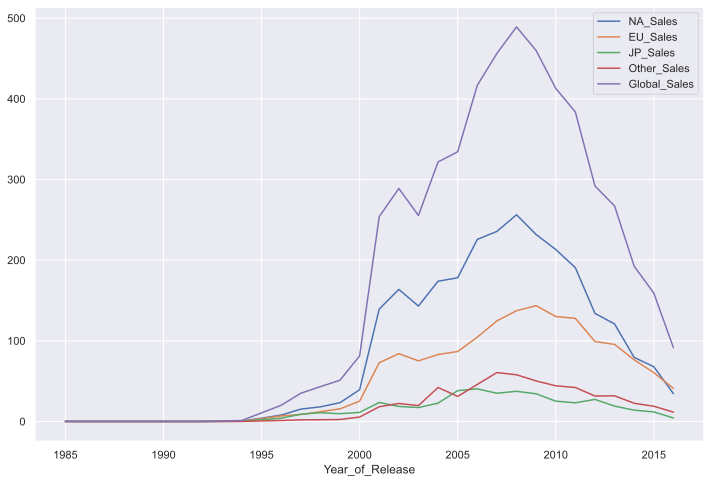

In [16]:
df[[x for x in df.columns if 'Sales' in x] + ['Year_of_Release']].groupby('Year_of_Release').sum().plot()

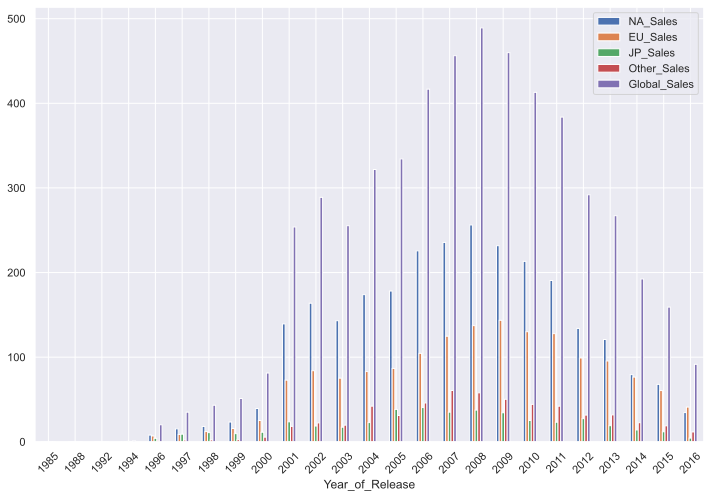

In [17]:
df[[x for x in df.columns if 'Sales' in x] + ['Year_of_Release']].groupby('Year_of_Release').sum().plot(kind = 'bar', rot = 45)

In [20]:
sns.pairplot( df[['Global_Sales',"Critic_Score", "Critic_Count", "User_Score", "User_Count"]])

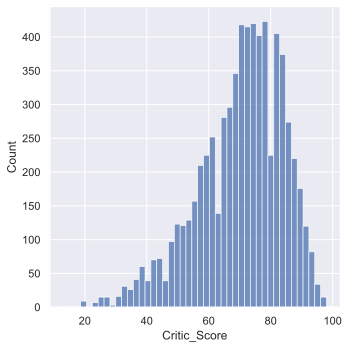

In [21]:
sns.displot(df['Critic_Score'])

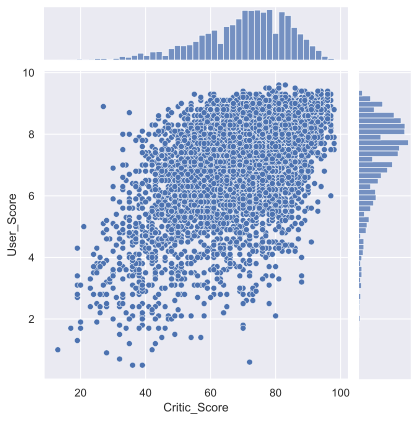

In [24]:
sns.jointplot(x = 'Critic_Score', y = 'User_Score', data = df, kind ='scatter')

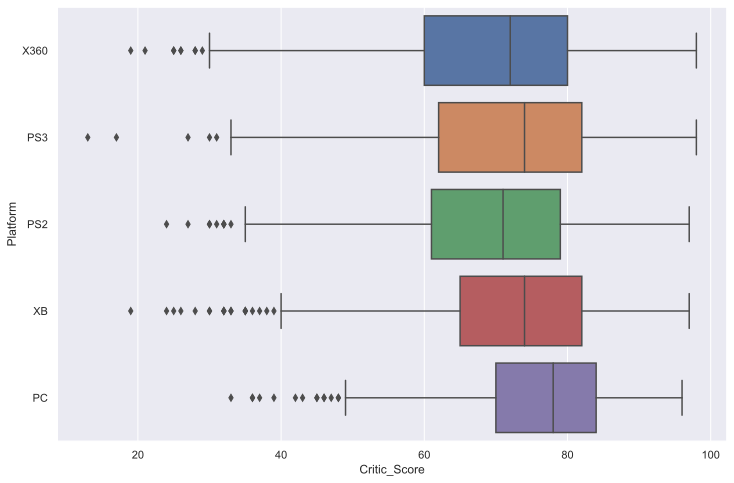

In [28]:
top_platforms = df['Platform'].value_counts().sort_values(ascending = False).head(5).index.values
sns.boxplot(x = 'Critic_Score', y = 'Platform', data = df[df['Platform'].isin(top_platforms)])

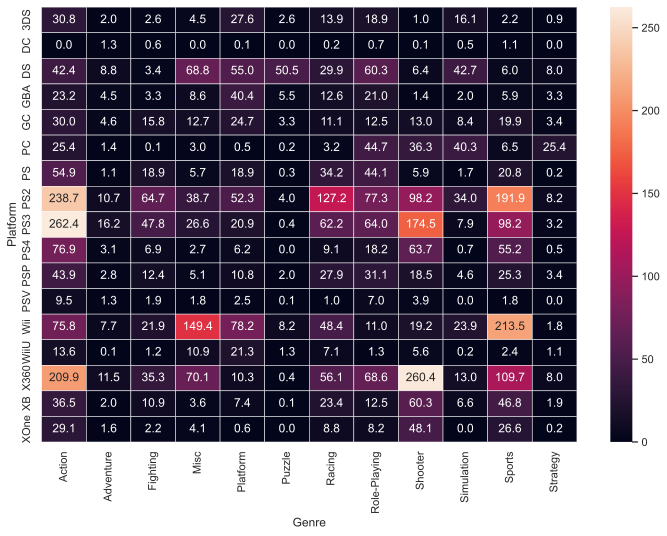

In [29]:
platform_genre_sales = df.pivot_table(index = 'Platform',columns = 'Genre', values = 'Global_Sales', aggfunc=sum).fillna(0).applymap(float)

sns.heatmap(platform_genre_sales, annot = True, fmt = '.1f', linewidths = 0.5)

In [30]:
import plotly
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot,plot

init_notebook_mode(connected = True)

In [32]:
years_df = df.groupby('Year_of_Release')[['Global_Sales']].sum().join(df.groupby('Year_of_Release')[['Name']].count())

years_df.columns = ['Global_Sales','Number_of_Games']

In [38]:
trace0 = go.Scatter(x = year_df.index, y = year_df['Global_Sales'], name = 'Global Sales')

trace1 = go.Scatter(x=years_df.index, y=years_df["Number_of_Games"], name="Number of games released"
)
data = [trace0, trace1]

layout = {'title' : 'Statistics for video games'}

fig = go.Figure(data = data, layout = layout)

iplot(fig,show_link = False)

In [39]:
plotly.offline.plot(fig, filename="years_stats.html", show_link=False, auto_open=False);

In [40]:
platform_df = df.groupby('Platform')[['Global_Sales']].sum().join(df.groupby('Platform')[['Name']].count())

,Global_Sales,Name
Platform,,
3DS,123.23,155
DC,4.55,14
DS,382.33,464
GBA,131.75,237
GC,159.42,348
PC,187.12,651
PS,206.55,150
PS2,945.97,1140
PS3,784.30,769


In [ ]:
platform_df.columns = ['Global_Sales','Number_of_Games']
platforms_df.sort_values('Global_Sales', ascending = False, inplace = True)